In [15]:
import pandas as pd
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')
import vectorbtpro as vbt
import plotly.graph_objects as go
import numpy as np
from numba import njit


In [16]:
vbt.settings.plotting["layout"]["template"] = "vbt_dark"
vbt.settings.plotting["layout"]["width"] = 800
vbt.settings.plotting['layout']['height'] = 350
vbt.settings.wrapping["freq"] = "1m"
# vbt.settings.portfolio['size_granularity'] = 0.001
vbt.settings.portfolio['init_cash'] = 10000

# Wherever you saved the pickle file
data_path = '/Users/ericervin/Documents/Coding/data-repository/data/BTCUSDT_1m.pkl'


If you want to pull in new data uncomment the following cell.

In [17]:
# symbol = 'BTCUSDT'
# data = vbt.BinanceData.fetch(symbols=symbol, start='2020-01-01', end='2020-12-31', interval='1m')
# data.save('data.pkl')

In [18]:
# Read in the 1m BTC data from pickle
data = vbt.BinanceData.load(data_path)

# # The data is a vbt object, run the .get() method to get the underlying pandas dataframe
# btc_1m = data.get()
# print(type(btc_1m)) # <class 'pandas.core.frame.DataFrame'>
# # Set columns to lowercase
# btc_1m.columns = btc_1m.columns.str.lower()
# # Print out the tail for sanity check
# btc_1m.tail()


## Mess around with standard deviation

In [19]:
# Draw multiple standard deviation bands and fix them on a daily basis

def add_support_resistance(df: pd.DataFrame, 
                           Close_col: str = 'Close', 
                           stdev_lbw: str = '30D', 
                           low_sigma: int = 1, 
                           high_sigma: int = 6, 
                           sigma_step: int = 1) -> pd.DataFrame:
    
    # Calculate rolling 1D standard deviation of Close prices
    std_dev = df[Close_col].rolling('1D').std()
    # Take the stdev_lbw-day rolling average of the 1D standard deviations
    df['avg_rolling_stddev'] = std_dev.rolling(stdev_lbw).mean()
    df['fixed_daily_stddev'] = df['avg_rolling_stddev'].at_time('00:00')
    df['fixed_daily_stddev'] = df['fixed_daily_stddev'].ffill()
    df['open_line'] = df[Close_col].at_time('00:00')
    df['open_line'] = df['open_line'].ffill()

    for sigma in range(low_sigma, high_sigma+1, sigma_step):
        df[f'daily_support_{sigma}'] = df['open_line'] - (df['fixed_daily_stddev'] * sigma)
        df[f'daily_support_{sigma}'] = df[f'daily_support_{sigma}'].ffill()

        df[f'daily_resistance_{sigma}'] = df['open_line'] + (df['fixed_daily_stddev'] * sigma)
        df[f'daily_resistance_{sigma}'] = df[f'daily_resistance_{sigma}'].ffill()
        
    return df




In [20]:
# Create a new copy of the dataframe with all the sigmas added
df_with_sigmas_added = add_support_resistance(data.get(), high_sigma = 12)
df_with_sigmas_added

,Open,High,Low,Close,Volume,Quote volume,Trade count,Taker base volume,Taker quote volume,avg_rolling_stddev,...,daily_support_8,daily_resistance_8,daily_support_9,daily_resistance_9,daily_support_10,daily_resistance_10,daily_support_11,daily_resistance_11,daily_support_12,daily_resistance_12
Open time,,,,,,,,,,,,,,,,,,,,,
2021-01-01 00:00:00+00:00,28923.63,28961.66,28913.12,28961.66,27.457032,7.943820e+05,1292,16.777195,4.853908e+05,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2021-01-01 00:01:00+00:00,28961.67,29017.50,28961.01,29009.91,58.477501,1.695803e+06,1651,33.733818,9.781765e+05,34.117902,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2021-01-01 00:02:00+00:00,29009.54,29016.71,28973.58,28989.30,42.470329,1.231359e+06,986,13.247444,3.840769e+05,29.164054,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2021-01-01 00:03:00+00:00,28989.68,28999.85,28972.33,28982.69,30.360677,8.800168e+05,959,9.456028,2.740831e+05,26.070147,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2021-01-01 00:04:00+00:00,28982.67,28995.93,28971.80,28975.65,24.124339,6.992262e+05,726,6.814644,1.975194e+05,24.006905,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-05-28 17:40:00+00:00,27286.59,27291.53,27286.59,27291.52,19.338620,5.276922e+05,339,17.440890,4.759094e+05,176.333001,...,25440.038621,28288.661379,25261.999698,28466.700302,25083.960776,28644.739224,24905.921854,28822.778146,24727.882931,29000.817069
2023-05-28 17:41:00+00:00,27291.53,27293.09,27291.52,27293.09,6.296240,1.718357e+05,277,3.392630,9.259073e+04,176.333356,...,25440.038621,28288.661379,25261.999698,28466.700302,25083.960776,28644.739224,24905.921854,28822.778146,24727.882931,29000.817069
2023-05-28 17:42:00+00:00,27293.09,27304.87,27293.08,27304.86,17.246730,4.708191e+05,486,14.848590,4.053561e+05,176.333707,...,25440.038621,28288.661379,25261.999698,28466.700302,25083.960776,28644.739224,24905.921854,28822.778146,24727.882931,29000.817069


In [21]:
# Create a plotting function that will let you plot the support and resistance lines over a given range of dates

def plot_daily_support_resistance(df: pd.DataFrame, 
                                  Close_col: str = 'Close', 
                                  low_sigma: int = 1, 
                                  high_sigma: int = 6, 
                                  from_date: str = None, 
                                  to_date: str = None):
    # If dates are provided, select that range from the dataframe
    if from_date and to_date:
        df = df.loc[from_date : to_date]
    else:
        df = df.iloc[-4*1440:]
    
    plt.figure(figsize=(14,7))
    
    # Plot Close price
    plt.plot(df.index, df[Close_col], label='Close Price', color='blue')

    # Plot support and resistance lines
    for sigma in range(low_sigma, high_sigma + 1):
        plt.plot(df.index, df[f'daily_support_{sigma}'], label=f'Support {sigma}σ', linestyle='--', alpha=0.3)
        plt.plot(df.index, df[f'daily_resistance_{sigma}'], label=f'Resistance {sigma}σ', linestyle='--', alpha=0.3)
    # Plot the open line
    plt.plot(df.index, df['open_line'], label='Open Line', linestyle='dashdot', color='black')

    plt.title('Daily Support and Resistance Levels')
    plt.xlabel('Date')
    plt.ylabel('Price')
    plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05), fancybox=True, shadow=True, ncol=5) # Move legend below the chart
    plt.grid(True)
    plt.show()


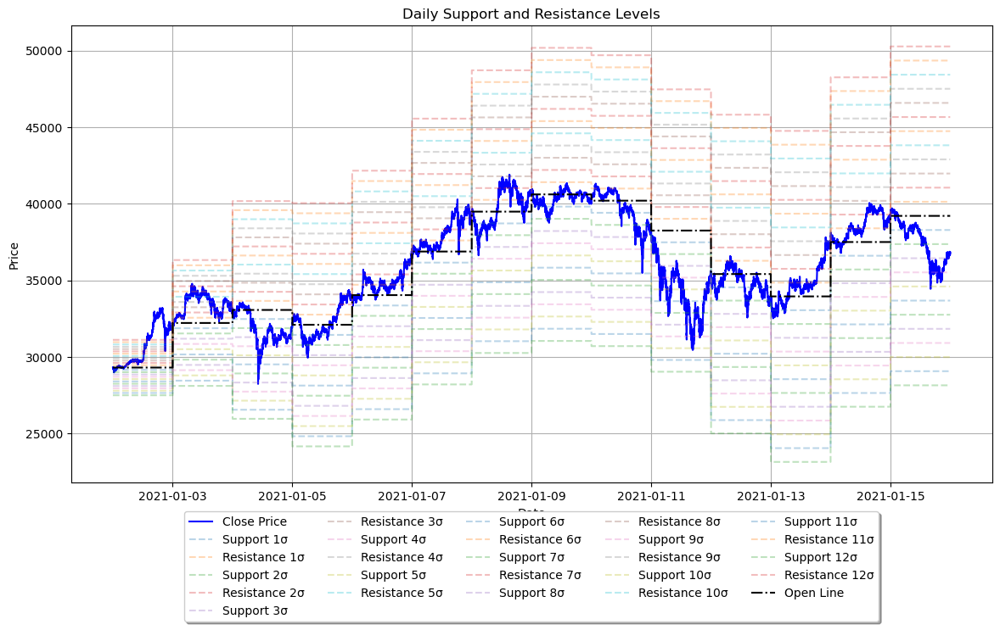

In [22]:
plot_daily_support_resistance(df_with_sigmas_added,
                              from_date='2021-01-02',
                              to_date='2021-01-15',
                              high_sigma=12,
                              )

In [23]:
df = df_with_sigmas_added.copy()

Create entries and exits based on the support and resistance levels.

In [168]:
short_entries = (
    df['Close'].vbt.crossed_above(df['daily_resistance_1']) |
    df['Close'].vbt.crossed_above(df['daily_resistance_2']) |
    df['Close'].vbt.crossed_above(df['daily_resistance_3']) |
    df['Close'].vbt.crossed_above(df['daily_resistance_4']) |
    df['Close'].vbt.crossed_above(df['daily_resistance_5']) |
    df['Close'].vbt.crossed_above(df['daily_resistance_6'])
)

short_exits = (
    df['Close'].vbt.crossed_below(df['daily_resistance_1']) |
    df['Close'].vbt.crossed_below(df['daily_resistance_2']) |
    df['Close'].vbt.crossed_below(df['daily_resistance_3']) |
    df['Close'].vbt.crossed_below(df['daily_resistance_4']) |
    df['Close'].vbt.crossed_below(df['daily_resistance_5']) |
    df['Close'].vbt.crossed_below(df['daily_resistance_6'])
)

entries = (
    df['Close'].vbt.crossed_below(df['daily_support_1']) |
    df['Close'].vbt.crossed_below(df['daily_support_2']) |
    df['Close'].vbt.crossed_below(df['daily_support_3']) |
    df['Close'].vbt.crossed_below(df['daily_support_4']) |
    df['Close'].vbt.crossed_below(df['daily_support_5']) |
    df['Close'].vbt.crossed_below(df['daily_support_6'])
)

exits = (
    df['Close'].vbt.crossed_above(df['daily_support_1']) |
    df['Close'].vbt.crossed_above(df['daily_support_2']) |
    df['Close'].vbt.crossed_above(df['daily_support_3']) |
    df['Close'].vbt.crossed_above(df['daily_support_4']) |
    df['Close'].vbt.crossed_above(df['daily_support_5']) |
    df['Close'].vbt.crossed_above(df['daily_support_6'])
)    


In [25]:
df['fixed_daily_stddev'] = df['fixed_daily_stddev'].bfill() # this is a hack to create a full array. TODO: drop na across entire df instead
df['fixed_daily_stddev']


Open time
2021-01-01 00:00:00+00:00    150.814273
2021-01-01 00:01:00+00:00    150.814273
2021-01-01 00:02:00+00:00    150.814273
2021-01-01 00:03:00+00:00    150.814273
2021-01-01 00:04:00+00:00    150.814273
                                ...    
2023-05-28 17:40:00+00:00    178.038922
2023-05-28 17:41:00+00:00    178.038922
2023-05-28 17:42:00+00:00    178.038922
2023-05-28 17:43:00+00:00    178.038922
2023-05-28 17:44:00+00:00    178.038922
Name: fixed_daily_stddev, Length: 1262872, dtype: float64

In [26]:
# Create entries and exits based on the fixed daily stddev
stops = df['fixed_daily_stddev'] # Going to set stops based on this. 


In [27]:
filter = '2021'
entries.loc[filter]

Open time
2021-01-01 00:00:00+00:00    False
2021-01-01 00:01:00+00:00    False
2021-01-01 00:02:00+00:00    False
2021-01-01 00:03:00+00:00    False
2021-01-01 00:04:00+00:00    False
                             ...  
2021-12-31 23:55:00+00:00    False
2021-12-31 23:56:00+00:00    False
2021-12-31 23:57:00+00:00    False
2021-12-31 23:58:00+00:00    False
2021-12-31 23:59:00+00:00    False
Length: 524607, dtype: bool

In [28]:
# print the number of entries and exits, short entries and short exits
# sum() will count the number of True values
print(f'Number of entries: {entries.sum()}')
print(f'Number of exits: {exits.sum()}')
print(f'Number of short entries: {short_entries.sum()}')
print(f'Number of short exits: {short_exits.sum()}')


Number of entries: 11591
Number of exits: 11222
Number of short entries: 10520
Number of short exits: 10110


In [29]:
clean_entries, clean_exits  = entries.vbt.signals.clean(exits)
clean_short_entries, clean_short_exits  = short_entries.vbt.signals.clean(short_exits)
print(f'Number of clean entries: {clean_entries.sum()}')
print(f'Number of clean exits: {clean_exits.sum()}')
print(f'Number of clean short entries: {clean_short_entries.sum()}')
print(f'Number of clean short exits: {clean_short_exits.sum()}')

Number of clean entries: 10479
Number of clean exits: 10479
Number of clean short entries: 9511
Number of clean short exits: 9510


In [170]:
# Create a portfolio object from the signals
year = '2021' # prevents the backtest from running out of memory
start_year = '2021' # prevents the backtest from running out of memory
end_year = '2023' # prevents the backtest from running out of memory
pf = vbt.Portfolio.from_signals(
    close=df.loc[start_year:end_year]['Close'],
    open = df.loc[start_year:end_year]['Open'],
    high = df.loc[start_year:end_year]['High'],
    low = df.loc[start_year:end_year]['Low'],
    entries=clean_entries[start_year:end_year],
    # exits=clean_exits[start_year:end_year],
    short_entries=clean_short_entries[start_year:end_year],
    # short_exits=clean_short_exits[start_year:end_year],
    leverage = 1,
    accumulate="AddOnly", # AddOnly, Both, RemoveOnly, False,
    # Play around with the following parameters for different results
    # size = 100,
    # size_type = 'value',
    # init_cash = 'auto',
    # max_orders = 3,

    # This is how i used to do size but I'm not sure if it's correct, Oleg told me to do it like the above section
    size = .1,
    size_type = 'percent',

    # Play around with stop losses and other exit strategies
    # tp_stop=0.005,
    # td_stop=480, # Time Delta Stop Trigger
    # time_delta_format = 'Rows',
    # sl_stop=.08, # Stop Loss Trigger
    # tsl_th = 0.02, # Trailing Stop Loss Profit Taking threshold
    # tsl_stop = 0.01, # Trailing Stop Loss Trigger
    tp_stop=stops[start_year:end_year] *1.5, # using a standard deviation based stop trigger
    delta_format = 'absolute', # tells the stop value to be the dollar amount rather than percentage
    freq='1m',
    fees=0.00015,
)
print(pf.stats())
# vbt.settings.plotting["layout"]["width"] = 800
vbt.settings.plotting['layout']['height'] = 200
pf.resample('1D').plot().show_svg()

Start                         2021-01-01 00:00:00+00:00
End                           2023-05-28 17:44:00+00:00
Period                                876 days 23:52:00
Start Value                                     10000.0
Min Value                                   9440.453912
Max Value                                  21529.141329
End Value                                  15954.660721
Total Return [%]                              59.546607
Benchmark Return [%]                          -5.381908
Total Time Exposure [%]                       57.861684
Max Gross Exposure [%]                       127.531673
Max Drawdown [%]                              38.520261
Max Drawdown Duration                 465 days 15:13:00
Total Orders                                      13444
Total Fees Paid                             2680.286413
Total Trades                                        877
Win Rate [%]                                  75.256556
Best Trade [%]                                 8

In [31]:
# Plot the support and resistance lines with the price for a given day
day = '2021-01-03'
# Set up the number of support and resistance lines to plot

num_supports = 6
num_resistances = 12
# Grab the support and resistance lines
support_cols = [f'daily_support_{i}' for i in range(1, num_supports + 1)]
resistance_cols = [f'daily_resistance_{i}' for i in range(1, num_resistances + 1)]
# Set up a list of columns to plot
cols_to_plot = ['Close', 'open_line'] + support_cols + resistance_cols
# Plot them
fig = df.loc[day][cols_to_plot].vbt.plot(width= 1200, height=400)
# Set the line styles
for i, trace in enumerate(fig.data):
    if trace.name == 'open_line':
        fig.data[i].line = dict(width=2, dash='dash')
    elif i >= 2:  # Skip the 'Close' and 'open_line' traces
        # Set the other linestyles to dots and smaller width
        fig.data[i].line = dict(width=0.5, dash='dot')
# Add the orders
pf[day].orders.plot(fig=fig)
fig.show()


In [18]:
pf[day].orders.plot().show()

# Create a signal cleaning operation
The idea here is to clean the all of the entry signals between the first resistance cross and the next one. 

In [79]:
# Find columns that contain 'daily_resistance' or 'daily_support'
resistance_cols = [col for col in df.columns if 'daily_resistance' in col]
support_cols = [col for col in df.columns if 'daily_support' in col]

# Create empty DataFrame to store signals
short_entries = pd.DataFrame(index=df.index)
short_exits = pd.DataFrame(index=df.index)
entries = pd.DataFrame(index=df.index)
exits = pd.DataFrame(index=df.index)

# Generate signals for each resistance/support line
for i, res_col in enumerate(resistance_cols, start=1):
    short_entries[f'signal_{i}'] = df['Close'].vbt.crossed_above(df[res_col])
    short_exits[f'signal_{i}'] = df['Close'].vbt.crossed_below(df[res_col])

for i, sup_col in enumerate(support_cols, start=1):
    entries[f'signal_{i}'] = df['Close'].vbt.crossed_below(df[sup_col])
    exits[f'signal_{i}'] = df['Close'].vbt.crossed_above(df[sup_col])

# Combine all signals
short_entries_combined = short_entries.any(axis=1)
short_exits_combined = short_exits.any(axis=1)
entries_combined = entries.any(axis=1)
exits_combined = exits.any(axis=1)


In [34]:
short_entries

,signal_1,signal_2,signal_3,signal_4,signal_5,signal_6,signal_7,signal_8,signal_9,signal_10,signal_11,signal_12
Open time,,,,,,,,,,,,
2021-01-01 00:00:00+00:00,False,False,False,False,False,False,False,False,False,False,False,False
2021-01-01 00:01:00+00:00,False,False,False,False,False,False,False,False,False,False,False,False
2021-01-01 00:02:00+00:00,False,False,False,False,False,False,False,False,False,False,False,False
2021-01-01 00:03:00+00:00,False,False,False,False,False,False,False,False,False,False,False,False
2021-01-01 00:04:00+00:00,False,False,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...
2023-05-28 17:40:00+00:00,False,False,False,False,False,False,False,False,False,False,False,False
2023-05-28 17:41:00+00:00,False,False,False,False,False,False,False,False,False,False,False,False
2023-05-28 17:42:00+00:00,False,False,False,False,False,False,False,False,False,False,False,False


In [38]:
print(f'Number of short entries for signal_1: {short_entries["signal_1"].sum()}')
print(f'Number of short entries for signal_2: {short_entries["signal_2"].sum()}')
clean_short_signal1_entries, clean_short_signal2_entries = short_entries['signal_1'].vbt.signals.clean(short_entries['signal_2'])
print(f'Number of short entries for signal_1 after cleaning with signal_2: {clean_short_signal1_entries.sum()} {clean_short_signal2_entries.sum()}')

Number of short entries for signal_1: 4898
Number of short entries for signal_2: 2541
Number of short entries for signal_1 after cleaning with signal_2: 442 442


### Clean function from polakow

In [97]:
@njit
def clean(entries_df, exits_df, short_entries_df, short_exits_df):
    num_cols = entries_df.shape[1]  # Assumes all dataframes have same number of columns

    clean_long_entries = np.full_like(entries_df, False)
    clean_long_exits = np.full_like(exits_df, False)
    clean_short_entries = np.full_like(short_entries_df, False)
    clean_short_exits = np.full_like(short_exits_df, False)
    
    for i in range(entries_df.shape[0]):
        trade_counter = 0
        for col in range(num_cols):
            if trade_counter == 0:
                if entries_df[i, col]:
                    trade_counter += 1
                    clean_long_entries[i, col] = True
                elif short_entries_df[i, col]:
                    trade_counter -= 1
                    clean_short_entries[i, col] = True
            elif trade_counter > 0:
                if exits_df[i, col]:
                    trade_counter -= 1
                    clean_long_exits[i, col] = True
                elif entries_df[i, col]:
                    if trade_counter < num_cols:
                        trade_counter += 1
                        clean_long_entries[i, col] = True
            elif trade_counter < 0:
                if short_exits_df[i, col]:
                    trade_counter += 1
                    clean_short_exits[i, col] = True
                elif short_entries_df[i, col]:
                    if trade_counter > -num_cols:
                        trade_counter -= 1
                        clean_short_entries[i, col] = True

    return clean_long_entries, clean_long_exits, clean_short_entries, clean_short_exits

clean_long_entries_full_df, clean_long_exits_full_df, clean_short_entries_full_df, clean_short_exits_full_df = clean(
    entries.values, 
    exits.values, 
    short_entries.values, 
    short_exits.values
)

# Convert to pandas DataFrame with same columns and index as original dataframes
clean_long_entries_full_df = pd.DataFrame(clean_long_entries_full_df, columns=entries.columns, index=entries.index)
clean_long_exits_full_df = pd.DataFrame(clean_long_exits_full_df, columns=exits.columns, index=exits.index)
clean_short_entries_full_df = pd.DataFrame(clean_short_entries_full_df, columns=short_entries.columns, index=short_entries.index)
clean_short_exits_full_df = pd.DataFrame(clean_short_exits_full_df, columns=short_exits.columns, index=short_exits.index)

# Convert to a single series (when you sum True values, they are converted to 1)
clean_long_entries = clean_long_entries_full_df.sum(axis=1).astype(bool)
clean_long_exits = clean_long_exits_full_df.sum(axis=1).astype(bool)
clean_short_entries = clean_short_entries_full_df.sum(axis=1).astype(bool)
clean_short_exits = clean_short_exits_full_df.sum(axis=1).astype(bool)


In [100]:
clean_long_entries_full_df.sum()

signal_1     5719
signal_2     2814
signal_3     1354
signal_4      887
signal_5      538
signal_6      310
signal_7      318
signal_8      174
signal_9      117
signal_10      99
signal_11      68
signal_12      46
dtype: int64

### Now we can select whichever signals we want to listen to. 


In [105]:
def get_signal_sum(df, start_signal, end_signal):
    """
    This function returns the sum along the row axis (axis=1) for a specified range of signal columns in a DataFrame.
    
    Parameters:
    df: The DataFrame containing the signals.
    start_signal: The starting signal number.
    end_signal: The ending signal number.
    
    Returns:
    A DataFrame containing the row sums for the specified range of signal columns.
    """
    signal_cols = [col for col in df.columns if 'signal' in col and start_signal <= int(col.split('_')[-1]) <= end_signal]
    return df[signal_cols].sum(axis=1).astype(bool)


here we are only going to isolate when the market has moved 3 std deviations and 12 stddev

In [130]:
clean_long_entries = get_signal_sum(clean_long_entries_full_df, 4, 12)
clean_long_exits = get_signal_sum(clean_long_exits_full_df, 4, 12)
clean_short_entries = get_signal_sum(clean_short_entries_full_df, 4, 12)
clean_short_exits = get_signal_sum(clean_short_exits_full_df, 4, 12)


In [162]:
# Now run a portfolio simulation with the cleaned signals
# Create a portfolio object from the signals
year = '2021' # prevents the backtest from running out of memory
start_year = '2021' # prevents the backtest from running out of memory
end_year = '2023' # prevents the backtest from running out of memory
pf = vbt.Portfolio.from_signals(
    close=df.loc[start_year:end_year]['Close'],
    open = df.loc[start_year:end_year]['Open'],
    high = df.loc[start_year:end_year]['High'],
    low = df.loc[start_year:end_year]['Low'],
    # entries=clean_long_entries[start_year:end_year],
    # exits=clean_long_exits[start_year:end_year],
    short_entries=clean_short_entries[start_year:end_year],
    # short_exits=clean_short_exits[start_year:end_year],
    leverage = 1,
    accumulate="AddOnly", # AddOnly, Both, RemoveOnly, False,
    # Play around with the following parameters for different results
    # size = 100,
    # size_type = 'value',
    # init_cash = 'auto',
    # max_orders = 3,

    # This is how i used to do size but I'm not sure if it's correct, Oleg told me to do it like the above section
    size = 0.10,
    size_type = 'percent',

    # Play around with stop losses and other exit strategies
    # tp_stop=0.005,
    # td_stop=480, # Time Delta Stop Trigger
    # time_delta_format = 'Rows',
    # sl_stop=.08, # Stop Loss Trigger
    # tsl_th = 0.02, # Trailing Stop Loss Profit Taking threshold
    # tsl_stop = 0.01, # Trailing Stop Loss Trigger
    tp_stop=df[start_year:end_year]['fixed_daily_stddev'] * 2,
    delta_format = 'absolute', # tells the stop value to be the dollar amount rather than percentage
    freq='1m',
    # fees=0.00015,
)
print(pf.stats())
# vbt.settings.plotting["layout"]["width"] = 800
vbt.settings.plotting['layout']['height'] = 200
pf.resample('1D').plot().show()

Start                         2021-01-01 00:00:00+00:00
End                           2023-05-28 17:44:00+00:00
Period                                876 days 23:52:00
Start Value                                     10000.0
Min Value                                    9163.35147
Max Value                                  13939.724549
End Value                                  10897.689872
Total Return [%]                               8.976899
Benchmark Return [%]                          -5.381908
Total Time Exposure [%]                       17.265883
Max Gross Exposure [%]                       151.625299
Max Drawdown [%]                              31.731961
Max Drawdown Duration                 675 days 13:24:00
Total Orders                                       2330
Total Fees Paid                                     0.0
Total Trades                                        167
Win Rate [%]                                  79.041916
Best Trade [%]                                 5

In [163]:
# Plot the support and resistance lines with the price for a given day
start_day = '2021-07-21'
end_day = '2021-07-27'
# Set up the number of support and resistance lines to plot

num_supports = 6
num_resistances = 12
# Grab the support and resistance lines
support_cols = [f'daily_support_{i}' for i in range(1, num_supports + 1)]
resistance_cols = [f'daily_resistance_{i}' for i in range(1, num_resistances + 1)]
# Set up a list of columns to plot
cols_to_plot = ['Close', 'open_line'] + support_cols + resistance_cols
# Plot them
fig = df.loc[start_day:end_day][cols_to_plot].vbt.plot(width= 1200, height=400)
# Set the line styles
for i, trace in enumerate(fig.data):
    if trace.name == 'open_line':
        fig.data[i].line = dict(width=2, dash='dash')
    elif i >= 2:  # Skip the 'Close' and 'open_line' traces
        # Set the other linestyles to dots and smaller width
        fig.data[i].line = dict(width=0.5, dash='dot')
# Add the orders
pf[start_day:end_day].orders.plot(fig=fig)
clean_long_exits.vbt.signals.plot_as_exits(trace_kwargs=dict(marker=dict(color="orange"), name="Long exits"), fig=fig)
clean_short_exits.vbt.signals.plot_as_exits(trace_kwargs=dict(marker=dict(color="magenta"), name="Short exits"), fig=fig)
fig.show()


In [164]:
pf.trades.records_readable[pf.trades.records_readable['Return'] < -.10]

,Exit Trade Id,Column,Size,Entry Order Id,Entry Index,Avg Entry Price,Entry Fees,Exit Order Id,Exit Index,Avg Exit Price,Exit Fees,PnL,Return,Direction,Status,Position Id
31,31,0,0.411598,440,2021-07-21 14:09:00+00:00,32113.525015,0.0,471,2021-07-26 01:03:00+00:00,38668.783833,0.0,-2698.129528,-0.204128,Short,Closed,31
147,147,0,0.486504,2016,2023-03-12 20:35:00+00:00,21836.467226,0.0,2043,2023-03-13 15:38:00+00:00,24023.253885,0.0,-1063.880860,-0.100144,Short,Closed,147


In [167]:
pf.orders.records_readable[pf.orders.records_readable['Fill Index'] =='2021-07-26 01:03:00+00:00']


,Order Id,Column,Signal Index,Creation Index,Fill Index,Size,Price,Fees,Side,Type,Stop Type
471,471,0,2021-07-26 01:02:00+00:00,2021-07-26 01:03:00+00:00,2021-07-26 01:03:00+00:00,0.411598,38668.783833,0.0,Buy,Market,TP


Problem with the above sigma stragegy is when we crossover into a new day. We really need some sort of rolling std dev based on the average price. Then we can tell the system to enter portions of the trade as it moves against us but exit the entire trade when we get a small profit. 

# Other cleaning methods

In [ ]:
clean_entries, clean_exits = entries.vbt.signals.clean(exits)
clean_short_entries, clean_short_exits = short_entries.vbt.signals.clean(short_exits)

In [ ]:
# Print the number of entries and exits, short entries and short exits
# sum() will count the number of True values
print(f'Number of entries: {clean_entries.sum()}')
print(f'Number of exits: {clean_exits.sum()}')
print(f'Number of short entries: {clean_short_entries.sum()}')
print(f'Number of short exits: {clean_short_exits.sum()}')


Number of entries: 10479
Number of exits: 10479
Number of short entries: 9511
Number of short exits: 9510


Better, but still a lot of trades

In [ ]:
# Create a portfolio object from the signals
year = '2021' # prevents the backtest from running out of memory
pf = vbt.Portfolio.from_signals(
    close=df.loc[year]['Close'],
    open = df.loc[year]['Open'],
    high = df.loc[year]['High'],
    low = df.loc[year]['Low'],
    entries=clean_entries[year],
    exits=clean_exits[year],
    short_entries=clean_short_entries[year],
    short_exits=clean_short_exits[year],
    accumulate=True, # True or false shouldn't matter because we cleaned our entries and exits
    size = 100,
    size_type = 'value',
    init_cash = 'auto',
    leverage = 1,
    # max_orders = 3,
    # size = .1,
    # size_type = 'percent',
    # sl_stop=.08,
    # td_stop=480,
    # time_delta_format = 'Rows',
    # tsl_th = 0.02,
    # tsl_stop = 0.01,
    freq='1m',
    # fees=0.00015,
)
print(pf.stats())
# vbt.settings.plotting["layout"]["width"] = 800
vbt.settings.plotting['layout']['height'] = 200
pf.resample('1D').plot().show()

: 

: 

In [ ]:
# remove the pf to save memory
del pf

## Try getting the signals but making sure they make sense

In [ ]:
lookback = 100

# Long Entry Conditions
long_cond1 = df['Close'].vbt.crossed_below(df['daily_support_1']) & ~df['Close'].vbt.crossed_below(df['open_line']).vbt.rolling_any(lookback)
long_cond2 = df['Close'].vbt.crossed_below(df['daily_support_2']) & ~df['Close'].vbt.crossed_below(df['daily_support_1']).vbt.rolling_any(lookback)
long_cond3 = df['Close'].vbt.crossed_below(df['daily_support_3']) & ~df['Close'].vbt.crossed_below(df['daily_support_2']).vbt.rolling_any(lookback)
long_cond4 = df['Close'].vbt.crossed_below(df['daily_support_4']) & ~df['Close'].vbt.crossed_below(df['daily_support_3']).vbt.rolling_any(lookback)
long_cond5 = df['Close'].vbt.crossed_below(df['daily_support_5']) & ~df['Close'].vbt.crossed_below(df['daily_support_4']).vbt.rolling_any(lookback)
long_cond6 = df['Close'].vbt.crossed_below(df['daily_support_6']) & ~df['Close'].vbt.crossed_below(df['daily_support_5']).vbt.rolling_any(lookback)

long_cond_dict = {1: long_cond1,
                  2: long_cond2,
                  3: long_cond3,
                  4: long_cond4,
                  5: long_cond5,
                  6: long_cond6,}

# Long Exit Conditions
long_exit_cond1 = df['Close'].vbt.crossed_above(df['daily_support_1'])
long_exit_cond2 = df['Close'].vbt.crossed_above(df['daily_support_2'])
long_exit_cond3 = df['Close'].vbt.crossed_above(df['daily_support_3'])
long_exit_cond4 = df['Close'].vbt.crossed_above(df['daily_support_4'])
long_exit_cond5 = df['Close'].vbt.crossed_above(df['daily_support_5'])
long_exit_cond6 = df['Close'].vbt.crossed_above(df['daily_support_6'])
 
# Short Entry Conditions
short_cond1 = df['Close'].vbt.crossed_above(df['daily_resistance_1']) & ~df['Close'].vbt.crossed_above(df['open_line']).vbt.rolling_any(lookback)
short_cond2 = df['Close'].vbt.crossed_above(df['daily_resistance_2']) & ~df['Close'].vbt.crossed_above(df['daily_resistance_1']).vbt.rolling_any(lookback)
short_cond3 = df['Close'].vbt.crossed_above(df['daily_resistance_3']) & ~df['Close'].vbt.crossed_above(df['daily_resistance_2']).vbt.rolling_any(lookback)
short_cond4 = df['Close'].vbt.crossed_above(df['daily_resistance_4']) & ~df['Close'].vbt.crossed_above(df['daily_resistance_3']).vbt.rolling_any(lookback)
short_cond5 = df['Close'].vbt.crossed_above(df['daily_resistance_5']) & ~df['Close'].vbt.crossed_above(df['daily_resistance_4']).vbt.rolling_any(lookback)
short_cond6 = df['Close'].vbt.crossed_above(df['daily_resistance_6']) & ~df['Close'].vbt.crossed_above(df['daily_resistance_5']).vbt.rolling_any(lookback)

short_cond_dict = {1: short_cond1,
                    2: short_cond2,
                    3: short_cond3,
                    4: short_cond4,
                    5: short_cond5,
                    6: short_cond6,}


# Short Exit Conditions
short_exit_cond1 = df['Close'].vbt.crossed_below(df['daily_resistance_1'])
short_exit_cond2 = df['Close'].vbt.crossed_below(df['daily_resistance_2'])
short_exit_cond3 = df['Close'].vbt.crossed_below(df['daily_resistance_3'])
short_exit_cond4 = df['Close'].vbt.crossed_below(df['daily_resistance_4'])
short_exit_cond5 = df['Close'].vbt.crossed_below(df['daily_resistance_5'])
short_exit_cond6 = df['Close'].vbt.crossed_below(df['daily_resistance_6'])

# Create a mask to avoid highly volatile periods

avoid_long_cond = long_cond1.vbt.rolling_any(lookback) | long_cond2.vbt.rolling_any(lookback) | long_cond3.vbt.rolling_any(lookback) | long_cond4.vbt.rolling_any(lookback) | long_cond5.vbt.rolling_any(lookback) | long_cond6.vbt.rolling_any(lookback)
avoid_short_cond = short_cond1.vbt.rolling_any(lookback) | short_cond2.vbt.rolling_any(lookback) | short_cond3.vbt.rolling_any(lookback) | short_cond4.vbt.rolling_any(lookback) | short_cond5.vbt.rolling_any(lookback) | short_cond6.vbt.rolling_any(lookback)


# Create a mask for long entries and exits
long_entry_mask = (long_cond1 | long_cond2 | long_cond3 | long_cond4 | long_cond5 | long_cond6)
long_exit_mask = (long_exit_cond1 | long_exit_cond2 | long_exit_cond3 | long_exit_cond4 | long_exit_cond5 | long_exit_cond6) # & ~avoid_long_cond # TODO may want to remvoe the avoid_long_cond
# Create a mask for short entries and exits
short_mask = (short_cond1 | short_cond2 | short_cond3 | short_cond4 | short_cond5 | short_cond6)
short_exit_mask = (short_exit_cond1 | short_exit_cond2 | short_exit_cond3 | short_exit_cond4 | short_exit_cond5 | short_exit_cond6) # & ~avoid_short_cond # TODO may want to remvoe the avoid_short_cond

In [ ]:
print(f'Long Entries {long_entry_mask.value_counts()}')
print(f'Long Exits {long_exit_mask.value_counts()}')
print(f'Short Entries {short_mask.value_counts()}')
print(f'Short Exits {short_exit_mask.value_counts()}')

# Count how many times we blew trhough six levels of support/resistance

for sigma_level in range(1,7):
    print(f'Number of times we blew through {sigma_level} levels of resistance with a {lookback} period lookback {short_cond_dict[sigma_level].value_counts()[1]}')
    print(f'Number of times we blew through {sigma_level} levels of support with a {lookback} period lookback {long_cond_dict[sigma_level].value_counts()[1]}')


Long Entries False    1255577
True        7295
Name: count, dtype: int64
Long Exits False    1251650
True       11222
Name: count, dtype: int64
Short Entries False    1256144
True        6728
Name: count, dtype: int64
Short Exits False    1252762
True       10110
Name: count, dtype: int64
Number of times we blew through 1 levels of resistance with a 100 period lookback 3560
Number of times we blew through 1 levels of support with a 100 period lookback 4251
Number of times we blew through 2 levels of resistance with a 100 period lookback 1536
Number of times we blew through 2 levels of support with a 100 period lookback 1624
Number of times we blew through 3 levels of resistance with a 100 period lookback 876
Number of times we blew through 3 levels of support with a 100 period lookback 704
Number of times we blew through 4 levels of resistance with a 100 period lookback 429
Number of times we blew through 4 levels of support with a 100 period lookback 405
Number of times we blew throug

In [ ]:
year = '2021'
pf = vbt.Portfolio.from_signals(
    close=df.loc[year]['Close'],
    open = df.loc[year]['Open'],
    high = df.loc[year]['High'],
    low = df.loc[year]['Low'],
    entries=long_entry_mask[year],
    # exits=long_exit_mask[year],
    short_entries=short_mask[year],
    # short_exits=short_exit_mask[year],
    accumulate=False,
    size = 100,
    size_type = 'value',
    init_cash = 'auto',
    leverage = 1,
    # max_orders = 3,
    # size = .1,
    # size_type = 'percent',
    # sl_stop=.08,
    # td_stop=480,
    # time_delta_format = 'Rows',
    tsl_th = 0.01,
    tsl_stop = 0.005,
    freq='1m',
    # fees=0.00015,
)
print(pf.stats())
# vbt.settings.plotting["layout"]["width"] = 800
vbt.settings.plotting['layout']['height'] = 200
pf.resample('1D').plot().show()


Start                         2021-01-01 00:00:00+00:00
End                           2021-12-31 23:59:00+00:00
Period                                364 days 07:27:00
Start Value                                  104.415467
Min Value                                     87.563669
Max Value                                    216.738174
End Value                                    197.650506
Total Return [%]                              89.292364
Benchmark Return [%]                            59.5797
Total Time Exposure [%]                       73.900463
Max Gross Exposure [%]                        133.44781
Max Drawdown [%]                              20.652924
Max Drawdown Duration                 126 days 12:32:00
Total Orders                                       1143
Total Fees Paid                                     0.0
Total Trades                                        634
Win Rate [%]                                  83.886256
Best Trade [%]                                 3

There is some great documentation here on cleaning up the signals. Have a look at the following link https://vectorbt.pro/pvt_ff5db015/tutorials/signal-development/generation/#truth-value-testing

In [ ]:
cols = df.columns
cols

Index(['Open', 'High', 'Low', 'Close', 'Volume', 'Quote volume', 'Trade count',
       'Taker base volume', 'Taker quote volume', 'avg_rolling_stddev',
       'fixed_daily_stddev', 'open_line', 'daily_support_1',
       'daily_resistance_1', 'daily_support_2', 'daily_resistance_2',
       'daily_support_3', 'daily_resistance_3', 'daily_support_4',
       'daily_resistance_4', 'daily_support_5', 'daily_resistance_5',
       'daily_support_6', 'daily_resistance_6'],
      dtype='object')

## Working with Ranks in VBT
here is the link https://vectorbt.pro/pvt_ff5db015/tutorials/signal-development/pre-analysis/#preset-rankers

In the following cells I will mess around with ranks and clean up a lot of the signals. For this I'm just going to focus on a long only strategy.

In [ ]:
# Here we are going to look at a long list of true or false signals but where we get a bunch of true's in a row
# from_nth(1) is the first time the signal is true and from_nth(2) is the second time the signal is true
# You can use this as a confirmation or perhaps a way to cool off by waiting for the signal to be true twice in a row

entry_sigma_cond1 = df['Close'] < df['daily_support_1'] # true for all times that the Close is below the daily support 1
entry_sigma_cond2 = df['Close'] > df['daily_support_2'] # true for all times that the Close is above the daily support 2

entries = entry_sigma_cond1 & entry_sigma_cond1
print(f'{entries.vbt.signals.from_nth(1).sum()}') # from_nth(1) is the first time the signal is true
print(f'{entries.vbt.signals.from_nth(200).sum()}')
print(f'{entries.vbt.signals.from_nth(300).sum()}') # from_nth(300) is the 300th time the signal is true

exit_sigma_cond1 = df['Close'] > df['open_line']

exits = exit_sigma_cond1
print(f'{exits.vbt.signals.from_nth(1).sum()}') # from_nth(1) is the first time the signal is true
print(f'{exits.vbt.signals.from_nth(200).sum()}')
print(f'{exits.vbt.signals.from_nth(300).sum()}') # from_nth(300) is the 300th time the signal is true

258564
127364
98479
612984
334993
270004


In [ ]:
# The following line will return the number of bars between entry and exit so by taking the max we get the longest trade
exits.vbt.signals.pos_rank_after(entries, reset_wait=0).max() +1 # max() +1 is the max number of bars between entry and exit

7931

In [ ]:
# The following line of code will give you the max number of bars between entry and exit
entries.vbt.signals.pos_rank_after(exits).max() + 1

2696

In [ ]:
# Here we are using vbt.signals.clean to remove any overlapping entries and exits. This is useful if you have multiple entry signals and you want to make sure you don't have overlapping entries and exits.

new_entries, new_exits = entries.vbt.signals.clean(exits)

In [ ]:
# Since these are boolean series, we can sum them to get the total number of entries and exits
print(f'New Entries {new_entries.sum()} and New Exits {new_exits.sum()}')

New Entries 794 and New Exits 794


When dealing with two masks, such as entry and exit signals, we're more likely interested in assessing the space between signals of both masks rather than signals in each mask separately. This can be realized by a mapping procedure that goes one signal at a time in the first mask and looks for one to many succeeding signals in the second mask, up until the next signal in the first mask. Such a procedure is implemented by the Numba-compiled function between_two_ranges_nb. The accessor method is the same as above - SignalsAccessor.between_ranges, which switches to the second mode if the argument other is specified. For example, let's get the average distance from each entry signal to its succeeding exit signal before and after cleaning:

In [ ]:
ranges = entries.vbt.signals.between_ranges(other=exits)

print(f'The average time delta between trades on the uncleaned signals is {ranges.avg_duration}')

The average time delta between trades on the uncleaned signals is 0 days 22:22:26.739591978


In [ ]:
new_ranges = new_entries.vbt.signals.between_ranges(other=new_exits)
print(f'The average time delta between trades on the cleaned signals is {new_ranges.avg_duration}')


The average time delta between trades on the cleaned signals is 0 days 08:12:56.599496221


In [ ]:
# The following code will give you a better understanding of the data
ranges.duration.describe(wrap_kwargs=dict(to_timedelta=True))

mean   0 days 22:22:26.739591978
std    0 days 21:58:35.358055162
min              0 days 00:01:00
25%              0 days 07:21:00
50%              0 days 16:10:00
75%              1 days 05:58:00
max              6 days 18:57:00
dtype: timedelta64[ns]

In [ ]:
new_ranges.duration.describe(wrap_kwargs=dict(to_timedelta=True))

mean   0 days 08:12:56.599496221
std    0 days 07:29:03.590712402
min              0 days 00:02:00
25%              0 days 02:21:00
50%              0 days 05:46:00
75%              0 days 11:53:45
max              1 days 23:48:00
dtype: timedelta64[ns]

In [ ]:
entries.vbt.signals.stats() # This will give you the stats for the uncleaned signals

Start                         2021-01-01 00:00:00+00:00
End                           2023-05-28 17:44:00+00:00
Period                                876 days 23:52:00
Total                                            264283
Rate [%]                                      20.927141
First Index                   2021-01-02 00:17:00+00:00
Last Index                    2023-05-25 02:58:00+00:00
Norm Avg Index [-1, 1]                        -0.055992
Distance: Min                           0 days 00:01:00
Distance: Median                        0 days 00:01:00
Distance: Max                           6 days 20:28:00
Total Partitions                                   5719
Partition Rate [%]                             2.163968
Partition Length: Min                   0 days 00:01:00
Partition Length: Median                0 days 00:03:00
Partition Length: Max                   0 days 23:28:00
Partition Distance: Min                 0 days 00:02:00
Partition Distance: Median              0 days 0

In [ ]:
exits.vbt.signals.stats()

Start                         2021-01-01 00:00:00+00:00
End                           2023-05-28 17:44:00+00:00
Period                                876 days 23:52:00
Total                                            623101
Rate [%]                                      49.339996
First Index                   2021-01-01 00:01:00+00:00
Last Index                    2023-05-28 17:44:00+00:00
Norm Avg Index [-1, 1]                        -0.009061
Distance: Min                           0 days 00:01:00
Distance: Median                        0 days 00:01:00
Distance: Max                           2 days 00:02:00
Total Partitions                                  10117
Partition Rate [%]                             1.623653
Partition Length: Min                   0 days 00:01:00
Partition Length: Median                0 days 00:04:00
Partition Length: Max                   0 days 23:59:00
Partition Distance: Min                 0 days 00:02:00
Partition Distance: Median              0 days 0

In [ ]:
new_entries.vbt.signals.stats() # This will give you the stats for the cleaned signals

Start                         2021-01-01 00:00:00+00:00
End                           2023-05-28 17:44:00+00:00
Period                                876 days 23:52:00
Total                                               794
Rate [%]                                       0.062873
First Index                   2021-01-02 00:17:00+00:00
Last Index                    2023-05-25 01:25:00+00:00
Norm Avg Index [-1, 1]                        -0.032626
Distance: Min                           0 days 00:14:00
Distance: Median                        0 days 20:00:00
Distance: Max                           6 days 23:16:00
Total Partitions                                    794
Partition Rate [%]                                100.0
Partition Length: Min                   0 days 00:01:00
Partition Length: Median                0 days 00:01:00
Partition Length: Max                   0 days 00:01:00
Partition Distance: Min                 0 days 00:14:00
Partition Distance: Median              0 days 2

In [ ]:
new_exits.vbt.signals.stats()

Start                         2021-01-01 00:00:00+00:00
End                           2023-05-28 17:44:00+00:00
Period                                876 days 23:52:00
Total                                               794
Rate [%]                                       0.062873
First Index                   2021-01-02 01:41:00+00:00
Last Index                    2023-05-25 12:01:00+00:00
Norm Avg Index [-1, 1]                        -0.031845
Distance: Min                           0 days 00:28:00
Distance: Median                        0 days 21:13:00
Distance: Max                           6 days 14:14:00
Total Partitions                                    794
Partition Rate [%]                                100.0
Partition Length: Min                   0 days 00:01:00
Partition Length: Median                0 days 00:01:00
Partition Length: Max                   0 days 00:01:00
Partition Distance: Min                 0 days 00:28:00
Partition Distance: Median              0 days 2

In [ ]:
# Plot the entries and exits
(new_entries.astype(int) - new_exits.astype(int))\
    .resample("1d").sum()\
    .vbt.ts_heatmap(
        trace_kwargs=dict(
            colorscale=["#ef553b", "rgba(0, 0, 0, 0)", "#17becf"],
            colorbar=dict(
                tickvals=[-1, 0, 1], 
                ticktext=["Exit", "", "Entry"]
            )
        )
    ).show()  

### Run a long only analysis
Let's have a look at this simple strategy that we created above

In [ ]:
year = '2022'

pf = vbt.Portfolio.from_signals(
    close=df.loc[year]['Close'],
    open = df.loc[year]['Open'],
    high = df.loc[year]['High'],
    low = df.loc[year]['Low'],
    entries=new_entries.loc[year],
    exits=new_exits.loc[year],
    # short_entries=short_mask[year],
    # short_exits=short_exit_mask[year],
    accumulate=False, # Set this to True and see the difference.
    size = 100,
    size_type = 'value',
    init_cash = 'auto',
    leverage = 1,
    # max_orders = 3,
    # size = .1,
    # size_type = 'percent',
    # sl_stop=.01,
    # td_stop=480,
    # time_delta_format = 'Rows',
    # tsl_th = 0.01,
    # tsl_stop = 0.005,
    freq='1m',
    # fees=0.00015,
)
print(pf.stats())
vbt.settings.plotting["layout"]["width"] = 600
vbt.settings.plotting['layout']['height'] = 200
pf.resample('1D').plot().show()


Start                         2022-01-01 00:00:00+00:00
End                           2022-12-31 23:59:00+00:00
Period                                365 days 00:00:00
Start Value                                  118.578025
Min Value                                     93.687815
Max Value                                    146.613209
End Value                                    114.785984
Total Return [%]                              -3.197929
Benchmark Return [%]                         -64.232649
Total Time Exposure [%]                       30.664193
Max Gross Exposure [%]                            100.0
Max Drawdown [%]                              36.098653
Max Drawdown Duration                 303 days 08:51:00
Total Orders                                        621
Total Fees Paid                                     0.0
Total Trades                                        311
Win Rate [%]                                  64.193548
Best Trade [%]                                  

Not bad actually. 

In [ ]:
# To understand what is happening under the hood show the trades
pf.trades.records_readable # This will show you the trades the records_readable is a handy method to simplify the output

,Exit Trade Id,Column,Size,Entry Order Id,Entry Index,Avg Entry Price,Entry Fees,Exit Order Id,Exit Index,Avg Exit Price,Exit Fees,PnL,Return,Direction,Status,Position Id
0,0,0,0.002129,0,2022-01-02 04:45:00+00:00,46966.55,0.0,1,2022-01-02 16:54:00+00:00,47812.57,0.0,1.801325,0.018013,Long,Closed,0
1,1,0,0.002123,2,2022-01-02 18:23:00+00:00,47110.63,0.0,3,2022-01-03 00:02:00+00:00,47253.00,0.0,0.302204,0.003022,Long,Closed,1
2,2,0,0.002144,4,2022-01-03 16:00:00+00:00,46635.11,0.0,5,2022-01-04 07:30:00+00:00,46529.55,0.0,-0.226353,-0.002264,Long,Closed,2
3,3,0,0.002176,6,2022-01-04 18:36:00+00:00,45963.87,0.0,7,2022-01-05 00:07:00+00:00,45903.62,0.0,-0.131081,-0.001311,Long,Closed,3
4,4,0,0.002222,8,2022-01-05 19:45:00+00:00,45006.98,0.0,9,2022-01-06 00:05:00+00:00,43479.36,0.0,-3.394185,-0.033942,Long,Closed,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
306,306,0,0.005934,612,2022-12-27 00:47:00+00:00,16853.39,0.0,613,2022-12-28 00:03:00+00:00,16706.46,0.0,-0.871813,-0.008718,Long,Closed,306
307,307,0,0.006018,614,2022-12-28 03:10:00+00:00,16618.01,0.0,615,2022-12-28 14:32:00+00:00,16723.43,0.0,0.634372,0.006344,Long,Closed,307
308,308,0,0.006020,616,2022-12-28 15:38:00+00:00,16611.72,0.0,617,2022-12-29 00:04:00+00:00,16556.04,0.0,-0.335185,-0.003352,Long,Closed,308
309,309,0,0.006041,618,2022-12-30 05:49:00+00:00,16553.42,0.0,619,2022-12-31 14:11:00+00:00,16617.75,0.0,0.388621,0.003886,Long,Closed,309


# Everything below is incomplete and WIP

## Setting stops based on an indicator
For example PSAR the parabolic stop and reverse indicator
or the Chande-Kroll Stop indicator for channels


In [ ]:
# Search for indicators named PSAR
vbt.IF.list_indicators("psar*")

['pandas_ta:PSAR', 'ta:PSARIndicator']

In [ ]:
# create a function to calculate the psar
import pandas_ta as ta
def generate_psar_stops(df, af_start=0.02, af_increment=0.02, af_max=0.2):
    psar = df.ta.psar(af_start=af_start, af_increment=af_increment, af_max=af_max)
    return psar
psar = generate_psar_stops(df)

KeyboardInterrupt: 

# Working with pattern recognition

In [ ]:
data = vbt.Data.from_data(df)

In [ ]:
data_window = data.loc['2021-01-01':'2021-01-31']

In [ ]:
# Use the typical price (average of high, low, Close) to smooth out the data
price_window = data_window.hlc3
price_window.vbt.plot().show()

This 👆 section is incomplete. 

# Work on multi time frame for bollinger band support and resistance levels

In [ ]:
# Create a resampled dataframe
# Create a dict for all the columns in the dataframe 


resample_dict = {'open': 'first', 'high': 'max', 'low': 'min', 
                 'Close': 'last', 'volume': 'sum', 'quote volume': 'sum', 
                 'trade count': 'sum', 'taker base volume': 'sum', 
                 'taker quote volume': 'sum', 'Close_daily_mean': 'mean', 
                 'rolling_std_dev_daily_mean': 'mean', 'daily_support_1': 'mean', 
                 'daily_resistance_1': 'mean', 'daily_support_2': 'mean', 
                 'daily_resistance_2': 'mean', 'daily_support_3': 'mean', 
                 'daily_resistance_3': 'mean', 'daily_support_4': 'mean', 
                 'daily_resistance_4': 'mean', 'daily_support_5': 'mean', 
                 'daily_resistance_5': 'mean', 'daily_support_6': 'mean', 
                 'daily_resistance_6': 'mean', 'open_line': 'mean'}

df_resampled = df.resample('1D').agg(resample_dict)

In [ ]:

h1_data = df.resample('1H').agg(resample_dict)

In [ ]:
h1_data.Close

In [ ]:
def generate_bandwidths(freqs):
    bandwidths = []
    for freq in freqs:
        Close = h1_data['Close'].resample(freq)
        bbands = vbt.talib("BBANDS").run(Close, skipna=True)
        upperband = bbands.upperband.ffill()
        middleband = bbands.middleband.ffill()
        lowerband = bbands.lowerband.ffill()
        bandwidth = (upperband - lowerband) / middleband
        bandwidths.append(bandwidth.vbt.resample_closing("1h"))  
        print(bandwidths)
    df = pd.concat(bandwidths, axis=1, keys=pd.Index(freqs, name="timeframe"))  
    return df.ffill()  

bandwidths = generate_bandwidths(["1h", "4h", "1d", "7d"])
bandwidths

In [ ]:
bandwidths.loc[:, ::-1].vbt.ts_heatmap().show()

In [ ]:
bbands = vbt.talib("BBANDS").run(
    h1_data.get("Close"), 
    skipna=True, 
    timeframe=["1h", "4h", "1d", "7d"],
    broadcast_kwargs=dict(wrapper_kwargs=dict(freq="1h"))  
)
bandwidth = (bbands.upperband - bbands.lowerband) / bbands.middleband
bandwidths

In [ ]:
def generate_signals(data, freq, fast_window, slow_window):
    open_price = data.resample(freq).get("Open")  
    fast_sma = vbt.talib("SMA")\
        .run(
            open_price, 
            fast_window, 
            skipna=True, 
            short_name="fast_sma"
        )\
        .real.ffill()\  
        .vbt.latest_at_index(data.wrapper.index)  
    slow_sma = vbt.talib("SMA")\
        .run(
            open_price, 
            slow_window, 
            skipna=True, 
            short_name="slow_sma"
        )\
        .real.ffill()\
        .vbt.latest_at_index(data.wrapper.index)
    entries = fast_sma.vbt.crossed_above(slow_sma)  
    exits = fast_sma.vbt.crossed_below(slow_sma)
    return entries, exits

fast_window = [10, 20]  
slow_window = [20, 30]
h1_entries, h1_exits = generate_signals(h1_data, "1h", fast_window, slow_window)
h4_entries, h4_exits = generate_signals(h1_data, "4h", fast_window, slow_window)
d1_entries, d1_exits = generate_signals(h1_data, "1d", fast_window, slow_win

entries = pd.concat(  
    (h1_entries, h4_entries, d1_entries), 
    axis=1, 
    keys=pd.Index(["1h", "4h", "1d"], name="timeframe")
)
exits = pd.concat(
    (h1_exits, h4_exits, d1_exits), 
    axis=1, 
    keys=pd.Index(["1h", "4h", "1d"], name="timeframe")


(entries.astype(int) - exits.astype(int))\
    .resample("1d").sum()\
    .vbt.ts_heatmap(
        trace_kwargs=dict(
            colorscale=["#ef553b", "rgba(0, 0, 0, 0)", "#17becf"],
            colorbar=dict(
                tickvals=[-1, 0, 1], 
                ticktext=["Exit", "", "Entry"]
            )
        )
    ).show()  


In [ ]:
(entries.astype(int) - exits.astype(int))\
    .resample("1d").sum()\
    .vbt.ts_heatmap(
        trace_kwargs=dict(
            colorscale=["#ef553b", "rgba(0, 0, 0, 0)", "#17becf"],
            colorbar=dict(
                tickvals=[-1, 0, 1], 
                ticktext=["Exit", "", "Entry"]
            )
        )
    ).show()  

In [ ]:
# Looking for the Chande-Kroll Stop indicator
vbt.IF.list_indicators("ch*")

['pandas_ta:CHOP',
 'ta:ChaikinMoneyFlowIndicator',
 'technical:CHAIKIN_MONEY_FLOW',
 'technical:CHOPINESS']

In [ ]:
# Hunt for indicators

# Search for a single indicator
print(vbt.IF.list_indicators("BBANDS*"))

# List out all the talib indicators
print(vbt.IndicatorFactory.list_talib_indicators())
# list out all the ta indicators
print(vbt.IndicatorFactory.list_ta_indicators())
# List out pandas_ta indicators
print(vbt.IndicatorFactory.list_pandas_ta_indicators())
# List out just the vectorbt indicators
print(vbt.IndicatorFactory.list_vbt_indicators())
# List out all the indicators
print(vbt.IndicatorFactory.list_indicators())


['vbt:BBANDS', 'talib:BBANDS', 'pandas_ta:BBANDS']
['ACOS', 'AD', 'ADD', 'ADOSC', 'ADX', 'ADXR', 'APO', 'AROON', 'AROONOSC', 'ASIN', 'ATAN', 'ATR', 'AVGPRICE', 'BBANDS', 'BETA', 'BOP', 'CCI', 'CDL2CROWS', 'CDL3BLACKCROWS', 'CDL3INSIDE', 'CDL3LINESTRIKE', 'CDL3OUTSIDE', 'CDL3STARSINSOUTH', 'CDL3WHITESOLDIERS', 'CDLABANDONEDBABY', 'CDLADVANCEBLOCK', 'CDLBELTHOLD', 'CDLBREAKAWAY', 'CDLCLOSINGMARUBOZU', 'CDLCONCEALBABYSWALL', 'CDLCOUNTERATTACK', 'CDLDARKCLOUDCOVER', 'CDLDOJI', 'CDLDOJISTAR', 'CDLDRAGONFLYDOJI', 'CDLENGULFING', 'CDLEVENINGDOJISTAR', 'CDLEVENINGSTAR', 'CDLGAPSIDESIDEWHITE', 'CDLGRAVESTONEDOJI', 'CDLHAMMER', 'CDLHANGINGMAN', 'CDLHARAMI', 'CDLHARAMICROSS', 'CDLHIGHWAVE', 'CDLHIKKAKE', 'CDLHIKKAKEMOD', 'CDLHOMINGPIGEON', 'CDLIDENTICAL3CROWS', 'CDLINNECK', 'CDLINVERTEDHAMMER', 'CDLKICKING', 'CDLKICKINGBYLENGTH', 'CDLLADDERBOTTOM', 'CDLLONGLEGGEDDOJI', 'CDLLONGLINE', 'CDLMARUBOZU', 'CDLMATCHINGLOW', 'CDLMATHOLD', 'CDLMORNINGDOJISTAR', 'CDLMORNINGSTAR', 'CDLONNECK', 'CDLPIERCING',

In [ ]:
# Get some help on the indicator
vbt.phelp(vbt.BBANDS.run)

BBANDS.run(
    close,
    window=Default(value=20),
    wtype=Default(value='simple'),
    alpha=Default(value=2),
    short_name='bb',
    hide_params=None,
    hide_default=True,
    **kwargs
):
    Run `BBANDS` indicator.
    
    * Inputs: `close`
    * Parameters: `window`, `wtype`, `alpha`
    * Outputs: `middle`, `upper`, `lower`
    * Lazy outputs: `percent_b`, `bandwidth`
    
    Pass a list of parameter names as `hide_params` to hide their column levels, or True to hide all.
    Set `hide_default` to False to show the column levels of the parameters with a default value.
    
    Other keyword arguments are passed to `BBANDS.run_pipeline`.


In [ ]:
bbands1_daily  = vbt.BBANDS.run(data.close, 1440, alpha=1) # 1 day, 1 std, 1 std
bbands2_daily  = vbt.BBANDS.run(data.close, 1440, alpha=2) # 1 day, 2 std, 2 std
bbands3_daily  = vbt.BBANDS.run(data.close, 1440, alpha=3) # 1 day, 3 std, 3 std
bbands1_hourly = vbt.BBANDS.run(data.close, 60, alpha=1) # 1 hour, 1 std, 1 std
bbands2_hourly = vbt.BBANDS.run(data.close, 60, alpha=2) # 1 hour, 2 std, 2 std
bbands3_hourly = vbt.BBANDS.run(data.close, 60, alpha=3) # 1 hour, 3 std, 3 std

# Plot the bands I'm creating a little date range so it doesn't plot the whole thing
start='2021-01-03' 
end='2021-01-06'
hourly_plot = bbands3_hourly[start:end].plot(height=300) # plot a single day to see what it looks like
bbands1_daily[start:end].plot(fig=hourly_plot) # add the daily bands to the hourly plot
bbands3_daily[start:end].plot(fig=hourly_plot).show() # add the daily 3 std bands to the hourly plot

In [ ]:

# Concat the stats for each band
bandwidth_stats = pd.concat([
                            bbands1_daily.bandwidth_stats(), 
                            bbands2_daily.bandwidth_stats(), 
                            bbands3_daily.bandwidth_stats(), 
                            bbands1_hourly.bandwidth_stats(), 
                            bbands2_hourly.bandwidth_stats(), 
                            bbands3_hourly.bandwidth_stats()], axis=1)
bandwidth_stats.columns = ['1 day std', '2 day std', '3 day std', '1H std', '2H std', '3H std']
bandwidth_stats

,1 day std,2 day std,3 day std,1H std,2H std,3H std
Start,2021-01-01 00:00:00+00:00,2021-01-01 00:00:00+00:00,2021-01-01 00:00:00+00:00,2021-01-01 00:00:00+00:00,2021-01-01 00:00:00+00:00,2021-01-01 00:00:00+00:00
End,2023-05-28 17:44:00+00:00,2023-05-28 17:44:00+00:00,2023-05-28 17:44:00+00:00,2023-05-28 17:44:00+00:00,2023-05-28 17:44:00+00:00,2023-05-28 17:44:00+00:00
Period,876 days 23:52:00,876 days 23:52:00,876 days 23:52:00,876 days 23:52:00,876 days 23:52:00,876 days 23:52:00
Count,1261433,1261433,1261433,1262813,1262813,1262813
Mean,0.024043,0.048087,0.07213,0.004668,0.009336,0.014004
Std,0.018228,0.036456,0.054685,0.0045,0.009001,0.013501
Min,0.000917,0.001834,0.002751,0.0,0.0,0.0
Median,0.019042,0.038083,0.057125,0.003396,0.006793,0.010189
Max,0.134986,0.269972,0.404958,0.140165,0.28033,0.420495
Min Index,2023-01-08 14:42:00+00:00,2023-01-08 14:42:00+00:00,2023-01-08 14:42:00+00:00,2021-02-11 03:18:00+00:00,2021-02-11 03:18:00+00:00,2021-02-11 03:18:00+00:00


In [ ]:
# Whoa 3std max bandwidth is .4049 let's identify when 
# high_volatility_plot = bbands3_hourly.bandwidth[bbands3_daily.bandwidth > 0.05].vbt.plot().show()

In [ ]:
# del high_volatility_plot # delete the plot to release the memory

In [ ]:
bbands3_hourly['5-19-2021'].plot().show() # plot the bandwidth for the 3 std hourly bands

Damn, what a massive day

In [ ]:
# Plot a histogram of the bandwidth
# bbands1.bandwidth.hist(bins=100).show_svg()

# hist = vbt.Histogram(bbands1_daily.bandwidth, trace_kwargs=dict(name='1 std'))
# fig = go.Figure(hist.fig)
# fig.update_layout(height=300, width=800)
# hist2 = vbt.Histogram(bbands3_hourly.bandwidth, trace_kwargs=dict(name='3 std', opacity=0.3), fig=fig)
# fig.show()


In [ ]:
# Very fat tail.
# del fig

In [ ]:
price = data.close

def bband_signal_generator_1(price, short_bband, long_bband):
    """
    Generate the entries and exits based on the price and the short and long bollinger bands
    """ 
    entries         = pd.Series(np.where((price < long_bband.middle) & (short_bband.bandwidth > long_bband.bandwidth), True, False))
    exits           = pd.Series(np.where((price > long_bband.middle) | (short_bband.bandwidth < long_bband.bandwidth), True, False)) # Note this is an OR statement
    short_entries   = pd.Series(np.where((price > long_bband.middle) & (short_bband.bandwidth > long_bband.bandwidth), True, False))
    short_exits     = pd.Series(np.where((price < long_bband.middle) | (short_bband.bandwidth < long_bband.bandwidth), True, False)) # Note this is an OR statement
    return entries, exits, short_entries, short_exits

def bband_signal_generator_2(price, short_bband, long_bband):
    """
    Generate the entries and exits based on the price and the short and long bollinger bands
    """ 
    entries = pd.Series(np.where((price < long_bband.lower) & (short_bband.bandwidth > long_bband.bandwidth), True, False))
    exits   = pd.Series(np.where((price > long_bband.lower) | (short_bband.bandwidth < long_bband.bandwidth), True, False)) # Note this is an OR statement
    short_entries = pd.Series(np.where((price > long_bband.upper) & (short_bband.bandwidth > long_bband.bandwidth), True, False))
    short_exits   = pd.Series(np.where((price < long_bband.upper) | (short_bband.bandwidth < long_bband.bandwidth), True, False)) # Note this is an OR statement
    return entries, exits, short_entries, short_exits





In [ ]:
# Run the function and receive the 4 arrays for entries and exits
entries, exits, short_entries, short_exits = bband_signal_generator_1(price, bbands1_hourly, bbands1_daily) 
# entries, exits, short_entries, short_exits = bband_signal_generator_2(price, bbands1_hourly, bbands1_daily) 

# Print the number of entries, exits, short entries and short exits
print(f'Number of entries: {entries.sum()}')
print(f'Number of exits: {exits.sum()}')
print(f'Number of short entries: {short_entries.sum()}')
print(f'Number of short exits: {short_exits.sum()}')




Number of entries: 8899
Number of exits: 1252534
Number of short entries: 8417
Number of short exits: 1253016


In [ ]:
clean_entries, clean_exits = entries.vbt.signals.clean(exits)
clean_short_entries, clean_short_exits = short_entries.vbt.signals.clean(short_exits)
print(f'Number of clean entries: {clean_entries.sum()}')
print(f'Number of clean exits: {clean_exits.sum()}')
print(f'Number of clean short entries: {clean_short_entries.sum()}')
print(f'Number of clean short exits: {clean_short_exits.sum()}')


Number of clean entries: 348
Number of clean exits: 348
Number of clean short entries: 323
Number of clean short exits: 323


# Play around
enter different crossovers, eg. (bbands3_hourly vs bbands1_daily) or (bbands3_hourly vs bbands3_daily)

In [ ]:

pf = vbt.Portfolio.from_signals(
    close = data.close,
    open = data.open,
    high = data.high,
    low = data.low,
    leverage = 2,
    accumulate = 'AddOnly',
    size=.1,
    size_type='percent',
    entries=clean_entries,
    exits=clean_exits,
    short_entries = clean_short_entries,
    short_exits = clean_short_exits,
    freq = '1m',
    # The following really help. comment these out to see what it looks like without them
    # tsl_th = 0.05,
    # tsl_stop = 0.005,
    tp_stop = 0.03,
    # sl_stop = 0.01,
    
)
def print_stats(pf):
    print(f'Total Return: {pf.total_return:.2%}')
    print(f'Win Rate: {pf.trades.win_rate:.2%}')
    print(f'Max Drawdown Percent: {pf.max_drawdown:.2%}')

    
print_stats(pf)

Total Return: 21.14%
Win Rate: 89.64%
Max Drawdown Percent: -12.48%


In [ ]:
pf.resample("1d").plot().show()